<a href="https://colab.research.google.com/github/praveenpiisc/cp250/blob/main/2_Network_Analysis_in_PyPSA_Earth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

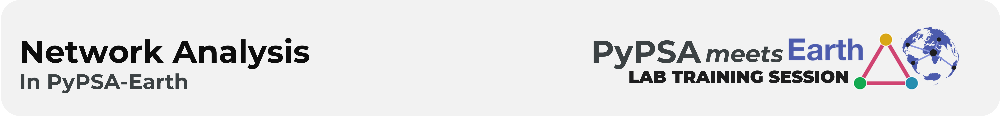

# 🌍 PyPSA-Earth: Network Analysis 🖇

<div style="display: flex; align-items: center; justify-content: space-between; gap: 1rem; flex-wrap: wrap;">

  <div style="flex: 1; min-width: 250px;">
    <p><strong>Authors:</strong><br>
    Eddy Jalbout – PhD Candidate, Fraunhofer IEG<br>

  <div style="flex: 0 0 auto;">
  <a href="https://openenergytransition.org/index.html" target="_blank">
      <img src="https://www.ieg.fraunhofer.de/content/dam/ieg/ieg.svg" height="60" alt="Open Energy Transition logo">
  </a>
  </div>

<div style="display: flex; align-items: center; gap: 10px;">

</div>


**Aim:**

This notebook provides a first analysis of some input, as well as results of the sector-coupled energy system modelling framework [PyPSA-Earth](https://github.com/pypsa-meets-earth/pypsa-earth). The scope is to analyse the results of an optimization run.

## ⚙️ Setup Environment

### ▪ Install packages

In [1]:
# @markdown Run this cell to install the necessary Python packages for the project.

!pip install pypsa atlite pandas geopandas xarray matplotlib hvplot geoviews plotly highspy holoviews folium mapclassify gdown snakemake country_converter py7zr fake_useragent

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.1/56.1 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.1/317.1 kB 20.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.8/127.8 kB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.5/175.5 kB 14.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 574.4/574.4 kB 36.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 47.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.5/47.5 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.7/69.7 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.7/161.7 kB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 65.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 67.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 kB 3.7 MB/s eta 0:00:00
   ━━━━

### ▪ Import packages

In [2]:
# @markdown Here, the necessary Python packages for this exercise are loaded into the notebook.
# @markdown
# @markdown **Note:** If you encounter an error, go to Runtime -> Restart session, you find this in the toolbar at the top of the website

import pypsa
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import LineString
import geopandas as gpd
from pypsa.plot import add_legend_circles, add_legend_lines, add_legend_patches

import gdown
from urllib.request import urlretrieve
from IPython.display import Code, SVG, Image, IFrame, display
import importlib.util
import warnings
warnings.filterwarnings("ignore")

# Standard library
import os
import sys
import warnings
import yaml
from pathlib import Path
from datetime import datetime

# Scientific stack
import numpy as np
import pandas as pd
import xarray as xr

# PyPSA + related ecosystem
import pypsa
import atlite
import highspy  # HiGHS solver backend

# Geospatial & mapping
import geopandas as gpd
import folium
import mapclassify
import cartopy
from cartopy import crs as ccrs

# Plotting & visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import holoviews as hv
import hvplot.pandas      # activates .hvplot accessor
import geoviews as gv
import json

# PyPSA plotting helpers
from pypsa.plot import add_legend_circles, add_legend_lines, add_legend_patches

print('🎉 You are all set up - Let us go into it')

🎉 You are all set up - Let us go into it


Let us grab a PyPSA network of Türkiye. It contains the current status, as well as a future optimized model of the Turkish energy system for the year 2050.

## ◼ Download prepared networks

In [3]:
# @markdown Let us grab a PyPSA network of Türkiye. It contains the current status, as well as a future optimized model of the Turkish energy system for the year 2050.

# @markdown We have prepared a case study that can be explored in this notebook. To allow users to interact with the data we have prepared a pre-solved network, since running this optimization is a computationally expensive task.
# @markdown   * `network.nc`: The solved network
# @markdown   * `country_shapes.geojson`: The geographic shape of our modeled region
# @markdown   * `gadm_shapes.geojson`: The administrative regions which we are using to cluster the country
# @markdown   * `config.yaml`: The main input file with all the settings of the model run

pd.options.plotting.backend = "plotly"

# --- Google Drive direct download URLs ---
urls = {
    "network.nc"            : "https://drive.google.com/uc?id=1Dquz0pjG0jjz0qB6t2zcEu0CwBG7FwIQ",
    "country_shapes.geojson": "https://drive.google.com/uc?id=1NLbZBYlKQWwlMD2UFjFjkyczQoz7SC6e",
    "gadm_shapes.geojson"   : "https://drive.google.com/uc?id=1iAfyhbKs1qtz6WsQScN5yrNZYjcbg0YN",
    "config.yaml"           : "https://drive.google.com/uc?id=1jXI1wwqoVD2L5Y_677HL3f1h3FBKPeNN",
}

# --- Download each file ---
for name, url in urls.items():
    print(f"⬇️  Downloading {name} from Google Drive...")
    try:
        gdown.download(url, name, quiet=False)
        print(f"✅ Saved as {name}\n")
    except Exception as e:
        print(f"❌ Failed to download {name}: {e}\n")

print("🎉 All downloads complete.")

⬇️  Downloading network.nc from Google Drive...


Downloading...
From (original): https://drive.google.com/uc?id=1Dquz0pjG0jjz0qB6t2zcEu0CwBG7FwIQ
From (redirected): https://drive.google.com/uc?id=1Dquz0pjG0jjz0qB6t2zcEu0CwBG7FwIQ&confirm=t&uuid=c16afb29-f984-4a90-a0b7-0ee1cee23c93
To: /content/network.nc
100%|██████████| 321M/321M [00:04<00:00, 79.6MB/s]


✅ Saved as network.nc

⬇️  Downloading country_shapes.geojson from Google Drive...


Downloading...
From: https://drive.google.com/uc?id=1NLbZBYlKQWwlMD2UFjFjkyczQoz7SC6e
To: /content/country_shapes.geojson
100%|██████████| 58.7k/58.7k [00:00<00:00, 22.1MB/s]


✅ Saved as country_shapes.geojson

⬇️  Downloading gadm_shapes.geojson from Google Drive...


Downloading...
From: https://drive.google.com/uc?id=1iAfyhbKs1qtz6WsQScN5yrNZYjcbg0YN
To: /content/gadm_shapes.geojson
100%|██████████| 10.7M/10.7M [00:00<00:00, 37.4MB/s]


✅ Saved as gadm_shapes.geojson

⬇️  Downloading config.yaml from Google Drive...


Downloading...
From: https://drive.google.com/uc?id=1jXI1wwqoVD2L5Y_677HL3f1h3FBKPeNN
To: /content/config.yaml
100%|██████████| 21.5k/21.5k [00:00<00:00, 33.6MB/s]

✅ Saved as config.yaml

🎉 All downloads complete.


Import the `network` to an object called `network` and additional data.

In [4]:
network = pypsa.Network('network.nc', warnings='ignore', engine='netcdf4')
gadm_shapes = gpd.read_file('gadm_shapes.geojson')
regions_onshore = gpd.read_file('country_shapes.geojson')
country_coordinates = regions_onshore.total_bounds[[0, 2, 1, 3]]
with open('config.yaml', "r") as f:
    cfg = yaml.safe_load(f)

## ◼ Explore our `nodes` regions.

Simple plot

<Axes: >

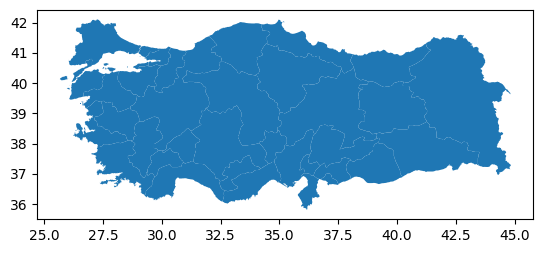

In [5]:
gadm_shapes.plot()

... or you can pick one region by itself

<Axes: >

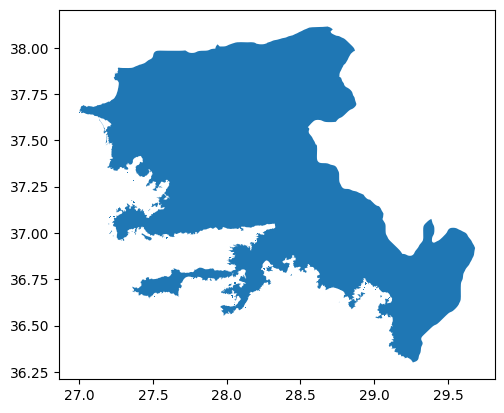

In [6]:
id = 'TR.11_1'
gadm_shapes[gadm_shapes.GADM_ID == id].plot()

To find out, which GADM ID represents which region, you can create an interactive map of the used shapes..

In [7]:
gadm_shapes.explore()

Or let's use a nice interactive plotting package to plot the regions.

`.hvplot()` is a powerful and interactive Pandas-like `.plot()` API. You just replace `.plot()` with `.hvplot()` and you get an interactive figure.

Here we chose to have each region colored based on population.

Documentation can be found here: https://hvplot.holoviz.org/index.html

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
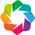

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (pop,GADM_ID,gdp)

In [8]:
hv.extension("bokeh")
gadm_shapes.hvplot(
    geo=True,
    tiles="OSM",
    hover_cols=["GADM_ID", "pop", "gdp"],
    c="pop",
    frame_height=700,
    frame_width=1000,
    alpha=0.4,
    legend=False,
).opts(xaxis=None, yaxis=None, active_tools=["pan", "wheel_zoom"])

## ◼ Inspect data in the network

_All data in a PyPSA model is stored as pandas DataFrames, allowing you to apply any standard pandas operations directly to PyPSA network components._

In [9]:
network.determine_network_topology()

PyPSA Network ''
----------------
Components:
 - Bus: 738
 - Carrier: 37
 - Generator: 540
 - GlobalConstraint: 2
 - Line: 67
 - Link: 2042
 - Load: 1061
 - StorageUnit: 20
 - Store: 457
 - SubNetwork: 704
Snapshots: 2920

In [ ]:
# Check the number of geographic buses (-> regions)
len(network.buses.location.unique())

37

In [10]:
network.buses.head()

,v_nom,type,x,y,carrier,unit,location,v_mag_pu_set,v_mag_pu_min,v_mag_pu_max,control,generator,sub_network,country
name,,,,,,,,,,,,,,
TR.11_1_AC,380.0,,28.010929,37.349064,AC,,,1.0,0.0,inf,Slack,TR.11_1_AC CCGT,0,TR
TR.12_1_AC,380.0,,27.851274,39.864507,AC,,,1.0,0.0,inf,PQ,,0,TR
TR.13_1_AC,380.0,,33.411361,41.177537,AC,,,1.0,0.0,inf,PQ,,0,TR
TR.14_1_AC,380.0,,41.058084,37.714448,AC,,,1.0,0.0,inf,PQ,,0,TR
TR.15_1_AC,380.0,,39.472068,40.741168,AC,,,1.0,0.0,inf,PQ,,0,TR


In [11]:
network.generators.head()

,bus,control,type,p_nom,p_nom_mod,p_nom_extendable,p_nom_min,p_nom_max,p_nom_set,p_min_pu,...,min_down_time,up_time_before,down_time_before,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,weight,p_nom_opt,emissions
name,,,,,,,,,,,,,,,,,,,,,
TR.11_1_AC CCGT,TR.11_1_AC,Slack,,63.000000,0.0,False,63.000000,inf,NaN,0.0,...,0,1,0,NaN,NaN,1.0,1.0,0.0,63.000000,0.187
TR.11_1_AC coal,TR.11_1_AC,,,960.000000,0.0,False,960.000000,inf,NaN,0.0,...,0,1,0,NaN,NaN,1.0,1.0,0.0,960.000000,0.354
TR.11_1_AC geothermal,TR.11_1_AC,,,516.984376,0.0,True,516.984376,878.111111,NaN,0.0,...,0,1,0,NaN,NaN,1.0,1.0,0.0,877.582283,0.026
TR.11_1_AC lignite,TR.11_1_AC,,,2095.000000,0.0,False,2095.000000,inf,NaN,0.0,...,0,1,0,NaN,NaN,1.0,1.0,0.0,2095.000000,0.334
TR.12_1_AC CCGT,TR.12_1_AC,,,931.000000,0.0,False,931.000000,inf,NaN,0.0,...,0,1,0,NaN,NaN,1.0,1.0,0.0,931.000000,0.187


Check the time series of generators

In [12]:
network.generators_t.p_max_pu.iloc[:, 0:5].head()

name,TR.11_1_AC csp,TR.11_1_AC offwind,TR.11_1_AC offwind2,TR.11_1_AC onwind,TR.11_1_AC onwind2
snapshot,,,,,
2013-01-01 00:00:00,0.000000,0.0,0.0,0.254985,0.000000
2013-01-01 03:00:00,0.000000,0.0,0.0,0.342346,0.000000
2013-01-01 06:00:00,0.313284,0.0,0.0,0.389415,0.000000
2013-01-01 09:00:00,0.744444,0.0,0.0,0.394579,0.000000
2013-01-01 12:00:00,0.790014,0.0,0.0,0.471668,0.016942


Visualize the first month's generation time series, aggregated by carrier.

In [13]:
network.generators_t.p.groupby(network.generators.carrier, axis=1).sum().loc['2013-01', :].plot()

Extract specific generators, for example one solar and one wind turbine.

In [ ]:
gen_mask = network.generators[
    (network.generators.carrier == 'solar') | (network.generators.carrier == 'onwind')
]
gen_mask.index
network.generators_t.p_max_pu.loc['2013-01', gen_mask.index[10:30]].plot()

#### ▪ `Statistics` module

---

📊 `pypsa.statistics`

The `pypsa.statistics` module provides a set of high-level functions for analyzing and summarizing the results of PyPSA models. It enables users to compute key metrics such as:

- **Generation mix** by technology  
- **Installed capacity** summaries  
- **Line loading** and **congestion metrics**  
- **Costs and revenues** by component  
- **CO₂ emissions** and carbon intensity  
- **Regional energy balances** and **power flows**

These functions are especially useful for post-processing model results and producing plots or reports for scenario analysis, capacity expansion studies, and policy evaluation.

The module works directly with the PyPSA `Network` object and leverages pandas operations internally, so results are returned as DataFrames that can be easily visualized or exported.




In [ ]:
s = network.statistics

You can easily have an comprehensive overview of the system level results and plot them, including Capacity Factor, Capital Expenditure, Curtailment, Installed Capacity, Operational Expenditure, Optimal Capacity, Revenue, Supply and Withdrawal

In [ ]:
s()

Optimal Capacity  \
Generator Biomass                                      3.500000e+01   
          Coal                                         9.344500e+04   
          Combined-Cycle Gas                           2.477754e+04   
          Geothermal                                   7.902210e+03   
          Lignite                                      2.921974e+04   
...                                                             ...   
Store     residential urban decentral water tanks      1.536346e+01   
          services rural water tanks                   1.408039e+01   
          services urban decentral water tanks         1.361099e+01   
          solid biomass                                2.784000e+08   
          urban central water tanks                    6.598270e+03   

                                                   Installed Capacity  \
Generator Biomass                                        3.500000e+01   
          Coal                                           9.344500e+04   
          Combined-Cycle Gas                             2.477754e+04   
          Geothermal                                     1.075585e+03   
          Lignite                                        2.921974e+04   
...                                                               ...   
Store     residential urban decentral water tanks        0.000000e+00   
          services rural water tanks                     0.000000e+00   
          services urban decentral water tanks           0.000000e+00   
          solid biomass                                  2.784000e+08   
          urban central water tanks                      0.000000e+00   

                                                         Supply    Withdrawal  \
Generator Biomass                                  2.708129e+05       0.00000   
          Coal                                     6.956456e+03       0.00000   
          Combined-Cycle Gas                       1.040370e+07       0.00000   
          Geothermal                               6.349317e+07       0.00000   
          Lignite                                  9.499050e+07       0.00000   
...                                                         ...           ...   
Store     residential urban decentral water tanks  1.737763e+03    2599.61152   
          services rural water tanks               3.103314e+02    1122.89763   
          services urban decentral water tanks     5.296570e+02    1309.06156   
          solid biomass                            1.386709e+08   34764.64841   
          urban central water tanks                6.076525e+05  613545.62890   

                                                   Energy Balance  \
Generator Biomass                                    2.708129e+05   
          Coal                                       6.956456e+03   
          Combined-Cycle Gas                         1.040370e+07   
          Geothermal                                 6.349317e+07   
          Lignite                                    9.499050e+07   
...                                                           ...   
Store     residential urban decentral water tanks   -8.618487e+02   
          services rural water tanks                -8.125662e+02   
          services urban decentral water tanks      -7.794046e+02   
          solid biomass                              1.386361e+08   
          urban central water tanks                 -5.893099e+03   

                                                   Transmission  \
Generator Biomass                                           0.0   
          Coal                                              0.0   
          Combined-Cycle Gas                                0.0   
          Geothermal                                        0.0   
          Lignite                                           0.0   
...                                                         ...   
Store     residential urban decentral water tanks 

Check Generators

In [ ]:
s(comps='Generator')

,Optimal Capacity,Installed Capacity,Supply,Withdrawal,Energy Balance,Transmission,Capacity Factor,Curtailment,Capital Expenditure,Operational Expenditure,Revenue,Market Value
Biomass,35.00000,35.00000,2.708129e+05,0.0,2.708129e+05,0.0,0.883278,3.578707e+04,1.109238e+07,4.053288e+06,1.565091e+07,57.792321
Coal,93445.00000,93445.00000,6.956456e+03,0.0,6.956456e+03,0.0,0.000008,8.185712e+08,1.374068e+10,1.677412e+05,4.542805e+05,65.303115
Combined-Cycle Gas,24777.54188,24777.54188,1.040370e+07,0.0,1.040370e+07,0.0,0.047932,2.066476e+08,2.442087e+09,4.911561e+08,8.020184e+08,77.089765
Geothermal,7902.21026,1075.58514,6.349317e+07,0.0,6.349317e+07,0.0,0.917222,5.730188e+06,3.148599e+09,6.278675e+05,3.495687e+09,55.056105
Lignite,29219.74476,29219.74476,9.499050e+07,0.0,9.499050e+07,0.0,0.371107,1.609745e+08,4.991374e+09,1.282148e+09,6.710317e+09,70.641986
Nuclear,4800.00000,4800.00000,3.428503e+07,0.0,3.428503e+07,0.0,0.815378,7.762969e+06,2.673892e+09,5.798516e+08,1.951052e+09,56.906813
Oil,3165.75156,3165.75156,2.413072e+02,0.0,2.413072e+02,0.0,0.000009,2.773174e+07,1.433461e+08,3.142703e+04,1.322403e+04,54.794555
Onshore Wind,8833.81932,8833.12174,7.994915e+06,0.0,7.994915e+06,0.0,0.103314,7.587772e+04,1.565431e+09,7.912362e+04,4.668052e+08,58.387770
Open-Cycle Gas,2263.67265,2263.55565,1.896186e+03,0.0,1.896186e+03,0.0,0.000096,1.982788e+07,1.228727e+08,1.107267e+05,1.163508e+05,61.360344
Run of River,1428.00000,1428.00000,3.891896e+06,0.0,3.891896e+06,0.0,0.311121,1.048605e+05,4.758916e+08,4.182511e+04,1.792288e+08,46.051794


Let's have a look to optimal Generators capacities.

In [ ]:
(
    s.optimal_capacity(
        bus_carrier=["AC", "low voltage"],
        comps="Generator",
    ).div(
        1e3
    )  # GW
)

,0
carrier,
Biomass,0.035000
Coal,93.445000
Combined-Cycle Gas,24.777542
Geothermal,7.902210
Lignite,29.219745
Nuclear,4.800000
Oil,3.165752
Onshore Wind,8.833819
Open-Cycle Gas,2.263673


---
📈 `pypsa.plot`

PyPSA also includes a built-in `pypsa.plot` module that provides a small set of standard plotting functions. These are useful for quickly visualizing key aspects of your network, such as:

- Network topology (buses, lines, generators)
- Line loading and power flows
- Generation dispatch over time
- Installed capacities and time-series data

These plots are useful for exploratory analysis and debugging and can be customized using `matplotlib`.

For more advanced or interactive visualizations, you may consider combining PyPSA outputs with external libraries such as `plotly`, `holoviews`, or `hvplot`.


Let's now plot the optimal renewable capacities that we investigated before.

In [ ]:
s.optimal_capacity(comps='Generator').sort_values(ascending=False).plot(kind='bar')

In [ ]:
network.statistics.capacity_factor()

component  carrier                                
Generator  Biomass                                    0.883278
           Coal                                       0.000008
           Combined-Cycle Gas                         0.047932
           Geothermal                                 0.917222
           Lignite                                    0.371107
                                                        ...   
Store      residential urban decentral water tanks    0.470741
           services rural water tanks                 0.484266
           services urban decentral water tanks       0.480522
           solid biomass                              0.747939
           urban central water tanks                  0.440729
Length: 123, dtype: float64

In [ ]:
network.statistics.energy_balance()

component  carrier                                  bus_carrier                            
Generator  Biomass                                  AC                                         2.708129e+05
           Coal                                     AC                                         6.956456e+03
           Combined-Cycle Gas                       AC                                         1.040370e+07
           Geothermal                               AC                                         6.349317e+07
           Lignite                                  AC                                         9.499050e+07
                                                                                                   ...     
Store      residential urban decentral water tanks  residential urban decentral water tanks   -8.618487e+02
           services rural water tanks               services rural water tanks                -8.125662e+02
           services urban decentral water tanks     services urban decentral water tanks      -7.794046e+02
           solid biomass                            solid biomass                              1.386361e+08
           urban central water tanks                urban central water tanks                 -5.893099e+03
Length: 190, dtype: float64

## ◼ Explore Demand ⚡

Check the attached loads

In [ ]:
network.loads.head()

,bus,carrier,type,p_set,q_set,sign,active
name,,,,,,,
TR.11_1_AC,TR.11_1_AC,AC,,0.0,0.0,-1.0,True
TR.12_1_AC,TR.12_1_AC,AC,,0.0,0.0,-1.0,True
TR.13_1_AC,TR.13_1_AC,AC,,0.0,0.0,-1.0,True
TR.14_1_AC,TR.14_1_AC,AC,,0.0,0.0,-1.0,True
TR.15_1_AC,TR.15_1_AC,AC,,0.0,0.0,-1.0,True


In [ ]:
network.statistics.energy_balance(comps=["Load"], aggregate_time="sum").reset_index()[['carrier', 0]].set_index('carrier').plot.bar(title="Loads in MW or Tonnes for Emissions")

#### ▪ Transport Sector


The demand of EVs, ICE (internal combustion engine) and FCEV (fuell cell)

In [ ]:
load_stats = network.statistics.energy_balance(comps=["Load"], aggregate_time="sum")
transport_stats_GWh = load_stats[load_stats.index.get_level_values('carrier').str.contains(
    'land transport oil(?! emissions)|land transport fuel cell|land transport EV',
    case=True)]
transport_stats_GWh

component  carrier                   bus_carrier
Load       land transport EV         Li ion        -84936400.0
           land transport fuel cell  H2             -9398700.0
           land transport oil        Oil           -79714900.0
dtype: float64

In [ ]:
transport_stats_TWh = transport_stats_GWh/1000000

transport_stats_TWh.reset_index()[['carrier', 0]].set_index('carrier').plot.bar(
    title='Demand of EVs, ICE and FCEV in [TWh]',
)

#### ▪ Heating Sector

The demand of various heating subsectors

In [ ]:
load_stats = network.statistics.energy_balance(comps=["Load"], aggregate_time="sum")
heating_stats_GWh = load_stats[load_stats.index.get_level_values('carrier').str.contains('heat', case=False)]
heating_stats_GWh

component  carrier                            bus_carrier                     
Load       low-temperature heat for industry  urban central heat                 -1.512425e+07
           residential rural heat             residential rural heat             -1.309161e+07
           residential urban decentral heat   residential urban decentral heat   -5.592232e+07
           urban central heat                 urban central heat                 -2.756606e+07
dtype: float64

In [ ]:
heating_stats_TWh = heating_stats_GWh/1000000

heating_stats_TWh.reset_index()[['carrier', 0]].set_index('carrier').plot.bar(
    title='The demand of various heating subsectors in [TWh]',
)

# ax.set_xticklabels(heating_stats_TWh.index.get_level_values('carrier'), rotation=45, ha="right")
# ax.grid(True)
# plt.show()

How is heating energy supplied (heat pump, district heating, resistive heater, gas boiler)

Gas Boiler: 50537585.76616001 MWh
Heat Pump: 20743604.01988 MWh
Resistive Heater: 10662205.211180001 MWh
CHP: 137116481.94829 MWh


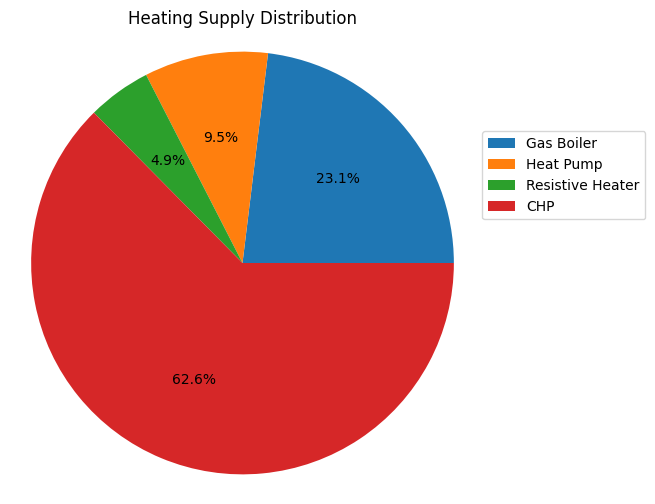

In [ ]:
heating_supply_stats = network.statistics.supply(comps=["Link"], aggregate_time="sum").loc[
    lambda x: x.index.get_level_values('carrier').str.contains('heat|boiler|pump|chp', case=False)
]

# Only the Gas boiler, heat pump, CHP, and resistive heater technologies are considered here
heating_types = ['Gas Boiler', 'Heat Pump', 'Resistive Heater', 'CHP']
heating_sums = [heating_supply_stats[heating_supply_stats.index.get_level_values('carrier').str.contains(heatingtype, case=False)].sum() for heatingtype in heating_types]

for ht, sum_value in zip(heating_types, heating_sums):
    print(f"{ht}: {sum_value} MWh")

plt.figure(figsize=(6, 6))
plt.pie(heating_sums, autopct='%1.1f%%')
plt.title('Heating Supply Distribution')
plt.legend(heating_types, loc='upper left', bbox_to_anchor=(1, 0.8))
plt.axis('equal')
plt.show()

## ◼ Explore Generation ⚡

Map carriers to better names and colors.

In [ ]:
n = network.copy()


#### ▪ Map colors and nice names for plotting

In [ ]:
# @markdown Run tis cell to map colors and nice names for carriers within the network for plotting.

# ---- Add a bus name to the links dataframe
n.links['bus'] =  n.links.index.str.replace(r"(_AC).*", r"\1", regex=True)

# --- Aggregate generator and storage capacities by bus and carrier ---
gen = n.generators[n.generators.carrier != "load"].groupby(["bus", "carrier"]).p_nom_opt.sum()
sto = n.storage_units.groupby(["bus", "carrier"]).p_nom_opt.sum()
lin = n.links.groupby(["bus", "carrier"]).p_nom_opt.sum()
loa = n.loads.groupby(["bus", "carrier"]).p_set.sum()
buses = pd.concat([gen, sto, lin, loa])

carriers_in_buses = buses.index.get_level_values('carrier').unique()

nice_names = cfg.get("plotting", {}).get("nice_names", {})
tech_colors = cfg.get("plotting", {}).get("tech_colors", {})

missing = []
for c in carriers_in_buses:
    if c not in n.carriers.index:
        missing.append(c)
    else:
        col = n.carriers.loc[c, 'color'] if 'color' in n.carriers.columns else None
        if pd.isna(col) or col == "":
            missing.append(c)
# print("Missing colors for carriers:", missing)

# ensure columns exist
for col in ['color', 'nice_name']:
    if col not in n.carriers.columns:
        n.carriers[col] = ""


for c in missing:
    # Ensure carrier exists in dataframe
    if c not in n.carriers.index:
        n.carriers.loc[c, "color"] = None
        n.carriers.loc[c, "nice_name"] = None

    # Assign color
    if c in tech_colors:
        n.carriers.loc[c, "color"] = tech_colors[c]
    else:
        n.carriers.loc[c, "color"] = "#808080"  # fallback grey

    # Assign nice_name
    if c in nice_names:
        n.carriers.loc[c, "nice_name"] = nice_names[c]
    else:
        # print("Missing nice name for carriers:", c)
        n.carriers.loc[c, "nice_name"] = c  # fallback to its own name

#### ▪ Map the current energy system capacity

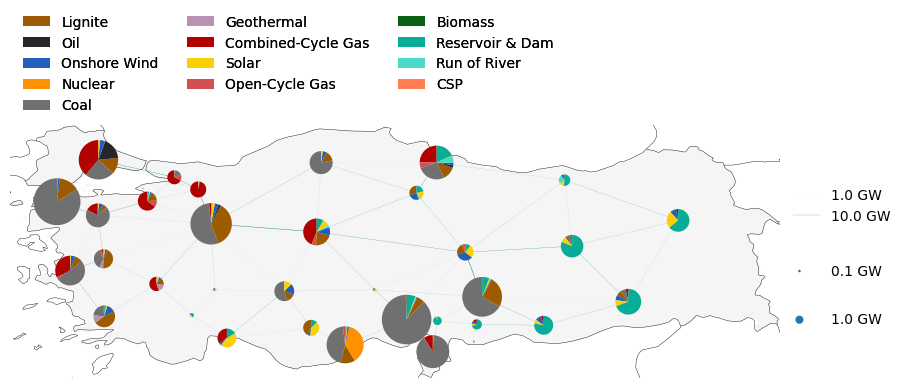

In [ ]:
# --- Scale settings ---
bus_scale = 6e4
line_scale = 6e4

# --- Legend settings ---
bus_sizes = [100, 1000]  # in MW
line_sizes = [1000, 10000]  # in MW

# --- Remove "Load" carrier for plotting ---
if "Load" in n.carriers.index:
    n.carriers.drop("Load", inplace=True)

# --- Aggregate generator and storage capacities by bus and carrier ---
gen = n.generators[n.generators.carrier != "load"].groupby(["bus", "carrier"]).p_nom.sum()
sto = n.storage_units.groupby(["bus", "carrier"]).p_nom.sum()
buses = pd.concat([gen, sto])

# --- Plotting ---
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={"projection": ccrs.PlateCarree()})

# --- Filter Links: only those that lie within GADM regions ---
# Extract the base part of the bus names
link_bus0_base = n.links.bus0.str.split("_AC").str[0]
link_bus1_base = n.links.bus1.str.split("_AC").str[0]

# Keep only links whose both ends are present in the GADM shapes
valid_links = n.links[
    link_bus0_base.isin(gadm_shapes.index) &
    link_bus1_base.isin(gadm_shapes.index) &
    (n.links.p_nom > 0)  # optional: only positive capacity
]

# overwrite temporarily for the plot
links_backup = n.links
n.links = valid_links

carriers_in_buses = buses.index.get_level_values('carrier').unique()
bus_colors = n.carriers['color'].reindex(carriers_in_buses).to_dict()

with plt.rc_context({"patch.linewidth": 0.}):
    n.plot(
        bus_sizes=buses / bus_scale,
        bus_alpha=1,
        line_widths=n.lines.s_nom / line_scale,
        link_widths=n.links.p_nom / line_scale,
        line_colors="teal",
        bus_colors=bus_colors,   # <- ensures all carriers have a color
        ax=ax,
        margin=0.2,
        # color_geomap=True,
    )

gadm_shapes.plot(
    ax=ax,
    facecolor="whitesmoke",
    edgecolor="white",
    aspect="equal",
    transform=ccrs.PlateCarree(),
    linewidth=0,
)

# Set map extent
bounds = gadm_shapes.total_bounds.copy()
pad_x = 2
bounds[2] += pad_x
# Extend above
pad_y = 8
bounds[3] += pad_y
bounds[1] -= 0.5*pad_y
ax.set_extent(bounds[[0, 2, 1, 3]])
ax.set_extent(gadm_shapes.total_bounds[[0, 2, 1, 3]])

# --- Add legends ---
legend_kwargs = {"loc": "upper left", "frameon": False}
legend_circles_dict = {"bbox_to_anchor": (1, 0.5), "labelspacing": 2.5, **legend_kwargs}

add_legend_circles(
    ax,
    [s / bus_scale for s in bus_sizes],
    [f"{s / 1000} GW" for s in bus_sizes],
    legend_kw=legend_circles_dict,
)
add_legend_lines(
    ax,
    [s / line_scale for s in line_sizes],
    [f"{s / 1000} GW" for s in line_sizes],
    legend_kw={"bbox_to_anchor": (1, 0.8), **legend_kwargs},
)

# --- Create patch legend for carriers (unique nice_name, non-zero capacity) ---
colors_legend = []
labels_legend = []
seen = set()
for c in n.carriers.index:
    name = n.carriers.loc[c, 'nice_name']
    color = n.carriers.loc[c, 'color']

    # Sum capacity over all buses for this carrier
    if c in buses.index.get_level_values('carrier'):
        val_total = buses.xs(c, level='carrier').sum()
    else:
        val_total = 0

    if name not in seen and val_total > 0:
        seen.add(name)
        colors_legend.append(color)
        labels_legend.append(name)

add_legend_patches(
    ax,
    colors_legend,
    labels_legend,
    legend_kw={"bbox_to_anchor": (0, 1),
               **legend_kwargs,
               "loc": "lower left",
               "ncol": 3,},
)

fig.tight_layout()
plt.show()

# Restore original links
n.links = links_backup

#### ▪ Map the future energy system capacity

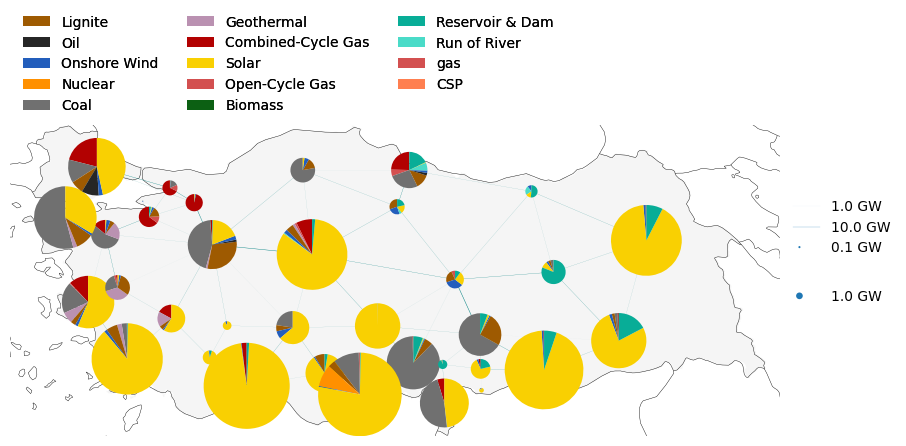

In [ ]:
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={"projection": ccrs.EqualEarth()})
# --- Aggregate capacities ---
gen = n.generators[n.generators.carrier != "load"].groupby(["bus", "carrier"]).p_nom_opt.sum()
sto = n.storage_units.groupby(["bus", "carrier"]).p_nom_opt.sum()
buses = pd.concat([gen, sto])

# --- Filter links ---
link_bus0_base = n.links.bus0.str.split("_AC").str[0]
link_bus1_base = n.links.bus1.str.split("_AC").str[0]
valid_links = n.links[
    link_bus0_base.isin(gadm_shapes.index) &
    link_bus1_base.isin(gadm_shapes.index) &
    (n.links.p_nom_opt > 0)
]
links_backup = n.links
n.links = valid_links

with plt.rc_context({"patch.linewidth": 0.}):
    n.plot(
        bus_sizes=buses / bus_scale,
        bus_alpha=1,
        line_widths=n.lines.s_nom_opt / line_scale,
        link_widths=n.links.p_nom_opt / line_scale,
        line_colors="teal",
        ax=ax,
        margin=0.2,
        # color_geomap=None,
    )

regions_onshore.plot(
    ax=ax,
    facecolor="whitesmoke",
    edgecolor="white",
    aspect="equal",
    transform=ccrs.PlateCarree(),
    linewidth=0,
)

# Zoom the map
ax.set_extent(regions_onshore.total_bounds[[0, 2, 1, 3]])

# Restore original links
n.links = links_backup

# --- Add legends ---
legend_kwargs = {"loc": "upper left", "frameon": False}
legend_circles_dict = {"bbox_to_anchor": (1, 0.67), "labelspacing": 2.5, **legend_kwargs}

add_legend_circles(
    ax,
    [s / bus_scale for s in bus_sizes],
    [f"{s / 1000} GW" for s in bus_sizes],
    legend_kw=legend_circles_dict,
)
add_legend_lines(
    ax,
    [s / line_scale for s in line_sizes],
    [f"{s / 1000} GW" for s in line_sizes],
    legend_kw={"bbox_to_anchor": (1, 0.8), **legend_kwargs},
)
# --- Create patch legend for carriers (unique nice_name, non-zero capacity) ---
colors_legend = []
labels_legend = []
seen = set()
for c in n.carriers.index:
    name = n.carriers.loc[c, 'nice_name']
    color = n.carriers.loc[c, 'color']

    # Sum capacity over all buses for this carrier
    if c in buses.index.get_level_values('carrier'):
        val_total = buses.xs(c, level='carrier').sum()
    else:
        val_total = 0

    if name not in seen and val_total > 0:
        seen.add(name)
        colors_legend.append(color)
        labels_legend.append(name)

add_legend_patches(
    ax,
    colors_legend,
    labels_legend,
    legend_kw={"bbox_to_anchor": (0, 1),
            **legend_kwargs,
            "loc": "lower left",
            "ncol": 3,},
)
fig.tight_layout()

#### ▪ Plot the capacity extension as bar chart

In [ ]:
optimal_capacity = network.statistics.optimal_capacity(comps=["Generator"]).droplevel(0).div(1e3)
installed_capacity = network.statistics.installed_capacity(comps=["Generator"]).droplevel(0).div(1e3)
generation_capacity_expansion = optimal_capacity - installed_capacity
# generation_capacity_expansion.drop(["load"], inplace=True)
generation_capacity_expansion.plot.bar(title="Generator capacity expansion in GW")

#### ▪ Share of different carrier by capacity

In [ ]:
# --- Extract data for generators ---
capacity_stats = network.statistics.installed_capacity(comps=["Generator"])
capacity_stats_non_zero = capacity_stats[capacity_stats != 0].dropna()
capacity_stats_plus = network.statistics.installed_capacity(comps=["StorageUnit"])
generator_capacity_by_carrier = pd.concat([capacity_stats_non_zero, capacity_stats_plus])

# --- Filter: keep only entries > 0 ---
generator_capacity_by_carrier = generator_capacity_by_carrier[generator_capacity_by_carrier > 0.1]

generator_capacity_by_carrier = generator_capacity_by_carrier.reset_index()[['carrier', 0]].set_index('carrier')

fig = px.pie(generator_capacity_by_carrier, values=0, names=generator_capacity_by_carrier.index, title="Generator Capacity by Carrier (GW)")
fig.show()

#### ▪ Share of different carriers by Energy

In [ ]:
energy_stats = network.statistics.energy_balance(comps=["Generator"])
electricity_energy_stats = energy_stats[energy_stats.index.get_level_values('bus_carrier') == 'AC']
electricity_energy_stats_plus = n.statistics.energy_balance(comps=["StorageUnit"])
combined_electricity_energy_stats = pd.concat([electricity_energy_stats, electricity_energy_stats_plus])

generator_energy_by_carrier = combined_electricity_energy_stats.reset_index()[['carrier', 0]].set_index('carrier')

fig = px.pie(generator_energy_by_carrier, values=0, names=generator_energy_by_carrier.index, title="Generator Energy by Carrier (GW)")
fig.show()

## ◼ Explore Energy Balance ⚖

In [ ]:

# Rename columns for better readability
rename_cols = {
    "-": "Load",
    "load": "load shedding",
}

# Calculate the energy balance, aggregate by carrier, and convert MWh to TWh
energy_balance = (
    n.statistics.energy_balance()
    # .loc[:, :, :]
    .loc[:, :, "AC"] # nur Stromsystem
    .groupby("carrier")
    .sum()
    .div(1e6)  # Convert MWh to TWh
    .to_frame()
    .T
    .rename(columns=rename_cols)
)

# Remove carriers with no energy flow
energy_balance = energy_balance.loc[:, (energy_balance != 0).any(axis=0)]


# --- Build long table for plotting (TWh) ---
df_plot = (
    energy_balance.melt(var_name="carrier_raw", value_name="TWh")
    .query("TWh != 0")
)

# Combine both mappings into one lookup dictionary
combined_colors = {
    **n.carriers["color"].to_dict(),  # from index
    **n.carriers.set_index("nice_name")["color"].dropna().to_dict(),
}

df_plot["color"] = df_plot["carrier_raw"].map(combined_colors).fillna("gray")

# # Combine both mappings into one lookup dictionary
# combined_names = {
#     **n.carriers.reset_index().set_index("nice_name")["name"].dropna().to_dict(),
#     **n.carriers["nice_name"].to_dict(),  # from index

# }

df_plot["carrier"] = df_plot["carrier_raw"].str.capitalize()

# df_plot["carrier"] = [
#     c if c[:1].isupper() else c.capitalize()
#     for c in df_plot["carrier_raw"]
# ]


color_map = dict(zip(df_plot["carrier"], df_plot["color"]))

# A single stacked bar (one column “AC”), segments per carrier
df_plot["system"] = "AC"

fig = px.bar(
    df_plot,
    x="system",                # one stacked column
    y="TWh",
    color="carrier",
    color_discrete_map=color_map,
    text_auto=".2f",
    title="Energy balance per carrier (AC, TWh)",
)

fig.update_layout(
    barmode="relative",
    template="plotly_white",
    xaxis_title="",
    yaxis_title="Energy [TWh]",
    legend_title="Carrier",
)
# nicer legend order: biggest first
order = (df_plot.groupby("carrier")["TWh"].sum()
         .sort_values(ascending=False).index.tolist()
)
fig.for_each_trace(lambda tr: tr.update(legendrank=order.index(tr.name)))

fig.show()



#### ▪ Energy Balance Timeseries

In [ ]:
# Rename columns for better readability
rename_cols = {
    "-": "Load",
    "load": "load shedding",
}

# Calculate the energy balance, aggregate by carrier, and convert MWh to TWh
energy_balance = (
    n.statistics.energy_balance(groupby_time=False)
    .loc[:, :, "AC"] # Electrcity only
    .groupby("carrier")
    .sum()
    .T
    .rename(columns=rename_cols)
)

# Remove carriers with no energy flow
energy_balance = energy_balance.loc[:, (energy_balance != 0).any(axis=0)]

# Total annual absolute energy contribution per carrier (in MWh)
annual_abs_energy = energy_balance.abs().sum(axis=0)

# Threshold in MWh
threshold_mwh = 1e6  # 1 TWh

# Keep only carriers with absolute annual energy >= 1 TWh
energy_balance = energy_balance.loc[:, annual_abs_energy >= threshold_mwh]

Let's take only a snippet of the whole year

In [ ]:
balance_slice = energy_balance.iloc[:300]

And let's plot it:

In [ ]:
import plotly.graph_objects as go
import numpy as np

# Split into positive and negative parts
pos = balance_slice.clip(lower=0)
neg = balance_slice.clip(upper=0)

# make mapping case-insensitive
color_map_ci = {k.lower(): v for k, v in color_map.items()}


x = balance_slice.index
fig = go.Figure()

# Positives: stacked upward from 0
for i, col in enumerate(pos.columns):
  fig.add_trace(go.Scatter(
      x=x,
      y=pos[col],
      stackgroup='positive',
      mode='none',
      name=f'{col}',
      fill='tonexty' if i > 0 else 'tozeroy',
      line=dict(color=color_map_ci[col.lower()]),
      fillcolor=color_map_ci[col.lower()],
      hovertemplate=f"Snapshot: %{{x}} {col}: %{{y:.2f}} MWh<extra></extra>"
  ))

# Negatives: stacked downward from 0
for i, col in enumerate(neg.columns):
  fig.add_trace(go.Scatter(
      x=x,
      y=neg[col],
      stackgroup='negative',
      mode='none',
      name=f'{col}',
      fill='tonexty' if i > 0 else 'tozeroy',
      hovertemplate=f"Snapshot: %{{x}} {col}: %{{y:.2f}} MWh<extra></extra>"
  ))

fig.update_layout(
    yaxis_title="Energy Balance (MWh)",
    xaxis_title="Time"
)


# one unified hover box with all traces at that x
fig.update_layout(
    hovermode="x unified",
    yaxis_title="Energy Balance [MWh_el]",
    xaxis_title="snapshot",
)
fig.show()


## ◼ Explore Networks 🕸

In [ ]:
network.links.head()

,bus0,bus1,type,carrier,efficiency,active,build_year,lifetime,p_nom,p_nom_mod,...,ramp_limit_shut_down,p_nom_opt,bus4,efficiency4,bus3,efficiency3,bus2,efficiency2,underwater_fraction,charger_ratio
name,,,,,,,,,,,,,,,,,,,,,
TR.11_1_AC co2 vent,TR.11_1_AC co2 stored,co2 atmosphere,,co2 vent,1.0,True,0,inf,0.0,0.0,...,1.0,0.015402,,1.0,,1.0,,1.0,0.0,NaN
TR.12_1_AC co2 vent,TR.12_1_AC co2 stored,co2 atmosphere,,co2 vent,1.0,True,0,inf,0.0,0.0,...,1.0,0.014134,,1.0,,1.0,,1.0,0.0,NaN
TR.13_1_AC co2 vent,TR.13_1_AC co2 stored,co2 atmosphere,,co2 vent,1.0,True,0,inf,0.0,0.0,...,1.0,0.008162,,1.0,,1.0,,1.0,0.0,NaN
TR.14_1_AC co2 vent,TR.14_1_AC co2 stored,co2 atmosphere,,co2 vent,1.0,True,0,inf,0.0,0.0,...,1.0,0.018465,,1.0,,1.0,,1.0,0.0,NaN
TR.15_1_AC co2 vent,TR.15_1_AC co2 stored,co2 atmosphere,,co2 vent,1.0,True,0,inf,0.0,0.0,...,1.0,0.015439,,1.0,,1.0,,1.0,0.0,NaN


#### ▪ Check the transmission lines

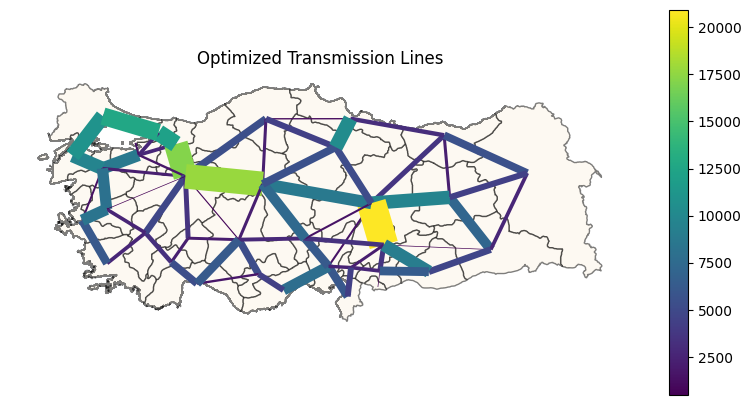

In [ ]:
# Construct GeoDataFrame of line geometries
geoms = [
    LineString([
        (network.buses.loc[bus0, "x"], network.buses.loc[bus0, "y"]),
        (network.buses.loc[bus1, "x"], network.buses.loc[bus1, "y"]),
    ])
    for bus0, bus1 in zip(network.lines.bus0, network.lines.bus1)
]

gdf = gpd.GeoDataFrame(network.lines, geometry=geoms, crs="EPSG:4326")

fig, ax = plt.subplots(figsize=(10, 5))
# Plot regions first (background)
gadm_shapes.plot(ax=ax, color="oldlace", edgecolor="black", alpha=0.5)

# Plot lines on top
gdf.plot(
    ax=ax,
    column="s_nom_opt",
    # linewidth=2,
    linewidth=gdf.s_nom_opt/1e3,
    cmap="viridis",
    legend=True,
)

plt.title("Optimized Transmission Lines")
plt.axis("off")
plt.show()

#### ▪ Check Hydrogen pipelines

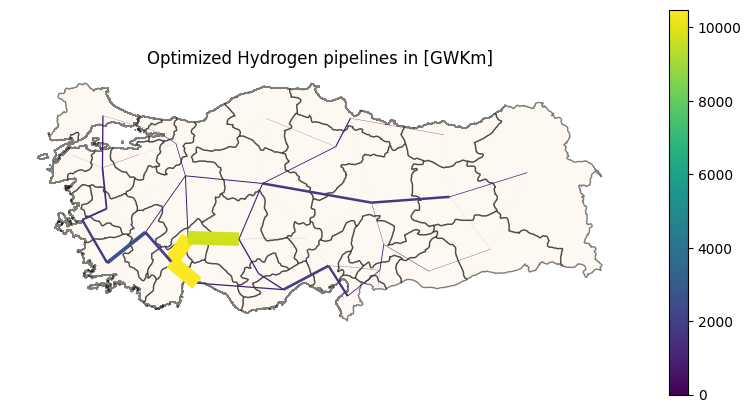

In [ ]:
h2_pipelines = network.links[network.links.carrier.str.contains('H2 pipeline')]

# Construct GeoDataFrame of line geometries
geoms = [
    LineString([
        (network.buses.loc[bus0, "x"], network.buses.loc[bus0, "y"]),
        (network.buses.loc[bus1, "x"], network.buses.loc[bus1, "y"]),
    ])
    for bus0, bus1 in zip(h2_pipelines.bus0, h2_pipelines.bus1)
]

gdf = gpd.GeoDataFrame(h2_pipelines, geometry=geoms, crs="EPSG:4326")

fig, ax = plt.subplots(figsize=(10, 5))
# Plot regions first (background)
gadm_shapes.plot(ax=ax, color="oldlace", edgecolor="black", alpha=0.5)

# Plot lines on top
gdf.plot(
    ax=ax,
    column="p_nom_opt",
    # linewidth=2,
    linewidth=gdf.p_nom_opt/1e3,
    cmap="viridis",
    legend=True,
)

plt.title("Optimized Hydrogen pipelines in [GWKm]")
plt.axis("off")
plt.show()

## ◼ Explore potentials

Map PV- and Wind potentials

In [ ]:
# @markdown Initiate -- **plot_res_potentials** -- function to plot PV and Wind potentials per region.

def plot_res_potentials(n, carrier, gadm_shapes, cmap):
    g = n.generators.loc[n.generators.carrier == carrier].copy()

    if not gadm_shapes.GADM_ID.str.contains("_AC").any():
      gadm_shapes["GADM_ID"] = gadm_shapes["GADM_ID"].astype(str) + "_AC"

    br = gadm_shapes.set_index("GADM_ID")
    br_area = br.to_crs("ESRI:54009")
    br_area = br_area.geometry.area * 1e-6
    br["p_nom_max"] = g.groupby("bus").sum().p_nom_max / br_area


    # build proper GeoJSON from GeoDataFrame
    geojson = json.loads(br.to_json())

    # reset index so GADM_ID is a column again for 'locations'
    br_plot = br.reset_index()

    fig = px.choropleth_map(br_plot, geojson=geojson, color="p_nom_max",
                            color_continuous_scale=cmap,
                            locations="GADM_ID", featureidkey="id",
                            center={
                                  "lat": br.geometry.centroid.y.mean(),
                                  "lon": br.geometry.centroid.x.mean()},
                            map_style="carto-positron", zoom=5,
                            opacity=0.8,
                            labels={'p_nom_max':'Potential Density<br>[MW/km2]'})
    carrier_map = {
        "solar": "Solar PV",
        "onwind": "Wind Onshore",
    }

    fig.update_layout(
        title={
            "text": f"<b>{carrier_map[carrier]} Potential Density by Region</b>",
            "x": 0.5
        }
    )
    fig.show()

In [ ]:
plot_res_potentials(n, "solar", gadm_shapes, "OrRd")

In [ ]:
plot_res_potentials(n, "onwind", gadm_shapes, "Blues")

### ⁉ Like to see more?

Check out the documentation here:

https://pypsa-earth.readthedocs.io/en/latest/

And some parts of this workshop notebook is adopted from OET here:

https://github.com/open-energy-transition/EIS-2025

And do not forget about the learning videos:

https://www.youtube.com/watch?v=hY5WgtZZv20&list=PLaXo6_ws0ZKJUYyUu-e6HRUcjuZnen7pA



